# CNN classifier to Object Detector using "Sliding Window" in OpenCV

In [23]:
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.applications import imagenet_utils
from imutils.object_detection import non_max_suppression
import numpy as np
import argparse
import imutils
import time
import cv2

In [25]:
# 슬라이딩 윈도우 생성
# 한번 호출될 때 마다 step 위치만큼 우측으로 이동, 그리고 아래로 이동하여 ws(window size) 크기의 이미지를 반환
def sliding_window(image, step, ws):
    # slide a window across the image
    for y in range(0, image.shape[0] - ws[1], step):
        for x in range(0, image.shape[1] - ws[0], step):
            # yield the current window
            yield (x, y, image[y:y + ws[1], x:x + ws[0]])

# 한번 호출될 때 마다 scale만큼 줄어든 이미지를 반환한다. 최소 크기 minSize 될때 까지
def image_pyramid(image, scale=1.5, minSize=(224, 224)):
    # yield the original image
    yield image

    # keep looping over the image pyramid
    while True:
        # compute the dimensions of the next image in the pyramid
        w = int(image.shape[1] / scale)
        image = imutils.resize(image, width=w)

        # if the resized image does not meet the supplied minimum
        # size, then stop constructing the pyramid
        if image.shape[0] < minSize[1] or image.shape[1] < minSize[0]:
            break

        # yield the next image in the pyramid
        yield image

# 실행될 파라매터 값 선언

In [26]:
args = {}
args["size"] = "(244, 244)"
args["image"] = "탐지할 이미지 객체 경로"
args["visualize"] = 1
args["min_conf"] = 0.83 # 이미지 예측 결과 정확도 허용값 (하이퍼 파라미터)

# 상수 선언

In [27]:
# 객체 탐지 과정에 사용되는 변수 입력
WIDTH = 600
PYR_SCALE = 1.5
WIN_STEP = 10
ROI_SIZE = eval(args["size"])
INPUT_SIZE = (224, 224)

# 사용할 CNN classifier 로딩

In [28]:
from keras.models import save_model,load_model
model = load_model('/CNN 분류 모델의 경로/res_net50modelWpatience_camp7.h5')

# 이미지 로딩

In [29]:
# 디스크에서 입력 이미지를로드하고 제공된 너비가되도록 크기를 조정 한 다음 차원을 가져옵니다.
orig = cv2.imread(args["image"])
orig = imutils.resize(orig, width=WIDTH)
(H, W) = orig.shape[:2]

# 대상 부분 이미지 준비

rois와 locs를 준비한다.
- rois : 관심 대상(region of interest)의 이미지 리스트
- locs : 관심 대상의 좌표 4개값의 리스트


In [30]:
# 이미지에서 생성 된 ROI를 보유하는 두 개의 목록을 초기화합니다.
# 피라미드 및 슬라이딩 창, 그리고 ROI가 원본 이미지에 있었던 (x, y) 좌표를 저장하는 데 사용되는 또 다른 리스트
rois = []  # 관심 대상(region of interest)의 이미지 리스트
locs = []  # 관심 대상의 좌표 4개값의 리스트

In [31]:
# 이미지 피라미드 레이어와 슬라이딩 윈도우 위치를 반복하는 데 걸리는 시간
start = time.time()

In [32]:
from matplotlib import pyplot as plt

# rois, locs 구하기

pyramid(다양한 스케일의 영역)에 대하여 루프를 돌고,

윈도우 슬라이딩(위치를 변경하며)에 대한 루프를 돌면서

관심 영역(ROI)의 이미지를 구하여 rois에 넣고, 좌표를 locs에 넣는다.

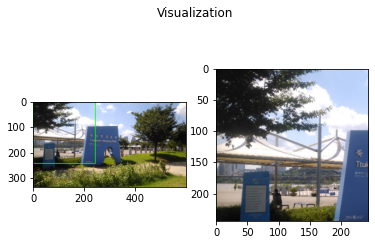

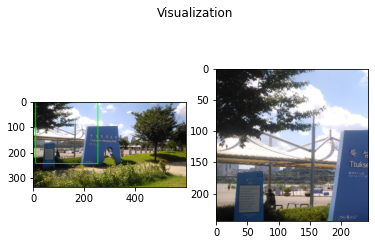

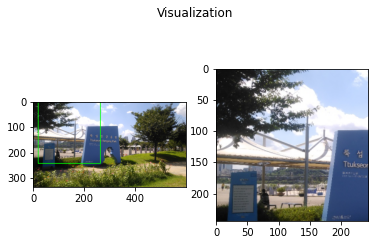

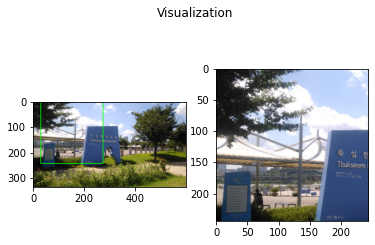

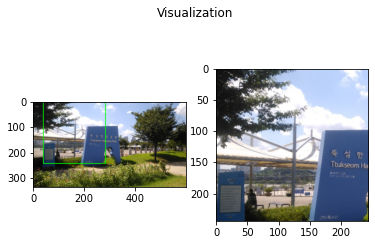

...

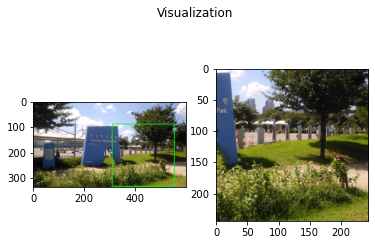

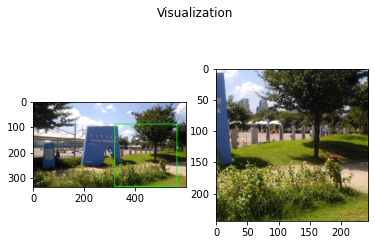

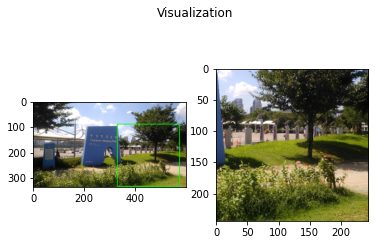

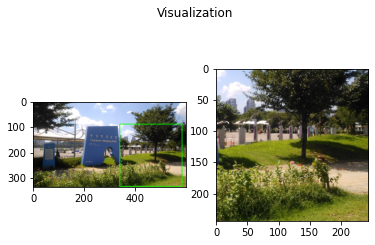

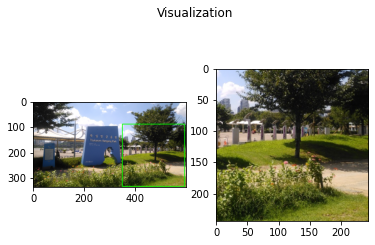

In [33]:
for image in image_pyramid(orig, scale=PYR_SCALE, minSize=ROI_SIZE):
    # * 원본 * 이미지 크기와 피라미드의 * 현재 * 레이어 사이의 배율을 결정합니다.
    scale = W / float(image.shape[1])

    # 이미지 피라미드의 각 레이어에 대해 슬라이딩 창 위치를 반복합니다.
    for (x, y, roiOrig) in sliding_window(image, WIN_STEP, ROI_SIZE):
        # * 원본 * 이미지 치수와 관련하여 ROI의 (x, y) 좌표를 조정합니다.
        x = int(x * scale)
        y = int(y * scale)
        w = int(ROI_SIZE[0] * scale)
        h = int(ROI_SIZE[1] * scale)

        # ROI를 가져와 사전 처리하여 나중에 Keras / TensorFlow를 사용하여 지역을 분류 할 수 있습니다.
        roi = cv2.resize(roiOrig, INPUT_SIZE)
        roi = img_to_array(roi)
        roi = roi/255.

        # ROI 및 관련 좌표 목록 업데이트
        rois.append(roi)
        locs.append((x, y, x + w, y + h))

        # 이미지 피라미드의 각 슬라이딩 윈도우를 시각화하고 있는지 확인합니다.
        if 1 > 0:
            # 원본 이미지를 복제 한 다음 현재 영역을 둘러싼 경계 상자를 그립니다.
            clone = orig.copy()
            cv2.rectangle(clone, (x, y), (x + w, y + h), (0, 255, 0), 2)

            clone2 = clone[:,:,::-1]
            roiOrig2 = roiOrig[:,:,::-1]

            fig, (ax1, ax2) = plt.subplots(1, 2)
            fig.suptitle('Visualization')
            ax1.imshow(clone2)
            ax2.imshow(roiOrig2)
            plt.show()

# 시각화 및 현재 ROI 표시

In [34]:
# 이미지 피라미드 레이어와 슬라이딩 윈도우 위치를 반복하는 데 걸린 시간 표시
end = time.time()
print("[INFO] looping over pyramid/windows took {:.5f} seconds".format(end - start))

[INFO] looping over pyramid/windows took 77.90843 seconds


In [35]:
# ROI를 NumPy 배열로 변환
rois = np.array(rois, dtype="float32")

# 각 이미지별 분류

rois에 담긴 부분 이미지들에 대한 분류 예측한 값들이 preds에 담긴다.

In [36]:
# ResNet을 사용하여 각 ROI를 분류 한 다음 분류에 걸린 시간 표시
print("[INFO] classifying ROIs...")
start = time.time()
preds = model.predict(rois)
end = time.time()
print("[INFO] classifying ROIs took {:.5f} seconds".format(
    end - start))

[INFO] classifying ROIs...
[INFO] classifying ROIs took 16.87468 seconds


# 출력된 값을 파싱

In [37]:
import pandas as pd
placename=pd.read_csv("labels.csv", header=None)
# placename[0]=range(1,393)
# placename=placename.set_index(0).to_dict()[1]
placename = placename.to_dict()[1]

In [38]:
placename

{0: '4.19학생혁명기념탑',
 1: '63시티',
 2: 'IFC몰',
 3: 'JW 메리어트 동대문 스퀘어 서울',
 4: 'JW 메리어트 호텔 서울',
 5: 'KBS 온',
 6: 'KT&G 상상마당',
 7: 'N 서울타워',
 8: 'NC백화점[강서]',
 9: 'NC백화점[구로]',
 10: 'NC백화점[불광]',
 11: 'NC백화점[송파]',
 12: 'campus7',
 13: '가든파이브',
 14: '가락시장',
 15: '가야대교',
 16: '가회동성당',
 17: '가회민화박물관',
 18: '강남구청',
 19: '강남도서관',
 20: '강남세브란스병원',
 21: '강남스타일 말춤 손목 조형물',
 22: '강남차병원',
 23: '강동구청',
 24: '강북구청',
 25: '강북문화예술회관',
 26: '강북문화정보도서관',
 27: '강북삼성병원',
 28: '강서구립가양도서관',
 29: '강서구립등빛도서관',
 30: '강서구청',
 31: '갤러리 현대 본관',
 32: '건국대학교 서울캠퍼스',
 33: '건국대학교병원',
 34: '겸재정선미술관',
 35: '경교장',
 36: '경기대학교 서울캠퍼스',
 37: '경리단길',
 38: '경복궁',
 39: '경운궁중명전',
 40: '경의선책거리',
 41: '경춘선숲길',
 42: '경희궁',
 43: '경희대학교 서울캠퍼스',
 44: '경희의료원',
 45: '고려대학교',
 46: '고려대학교구로병원',
 47: '고척스카이돔',
 48: '곰달래도서관',
 49: '관악구청',
 50: '관훈갤러리',
 51: '광운대학교',
 52: '광장시장',
 53: '광진정보도서관',
 54: '광통교',
 55: '광화문',
 56: '광화문 광장',
 57: '광희 패션몰',
 58: '광희문',
 59: '구공업전습소본관',
 60: '구러시아 공사관',
 61: '구로구청',
 62: '구로시장',
 63: '구서울대학교본관',
 64: '국립 4.

# 예측값 디코딩 함수

In [39]:
def decode_predictions(preds, top=5, **kwargs):
    """Decodes the prediction of an ImageNet model.
    # Arguments
        preds: Numpy tensor encoding a batch of predictions.
        top: Integer, how many top-guesses to return.
    # Returns
        A list of lists of top class prediction tuples
        `(class_name, class_description, score)`.
        One list of tuples per sample in batch input.
    # Raises
        ValueError: In case of invalid shape of the `pred` array
            (must be 2D).
    """
    global CLASS_INDEX

    #backend, _, _, keras_utils = get_submodules_from_kwargs(kwargs)

    if len(preds.shape) != 2 or preds.shape[1] != 392:
        raise ValueError('`decode_predictions` expects '
                         'a batch of predictions '
                         '(i.e. a 2D array of shape (samples, 1000)). '
                         'Found array with shape: ' + str(preds.shape))

    results = []
    for pred in preds:
        top_indices = pred.argsort()[-top:][::-1]
        result =[]
        for i in top_indices:
            res = (i+1,placename.get(i+1),pred[i])
            result.append(res)
            result.sort(key=lambda x: x[2], reverse=True)
        results.append(result)
    return results
decode_predictions(preds, top=1)

[[(130, '뚝섬한강공원', 0.9613006)],
 [(130, '뚝섬한강공원', 0.9240954)],
 [(130, '뚝섬한강공원', 0.8021889)],
 [(130, '뚝섬한강공원', 0.78294337)],
 [(130, '뚝섬한강공원', 0.67208517)],
 [(251, '신세계백화점[본점]', 0.48352414)],
 [(251, '신세계백화점[본점]', 0.6691794)],
 [(251, '신세계백화점[본점]', 0.59470683)],
 [(251, '신세계백화점[본점]', 0.63059366)],
 [(251, '신세계백화점[본점]', 0.59784895)],
 [(251, '신세계백화점[본점]', 0.3471332)],
 [(251, '신세계백화점[본점]', 0.28104687)],
 [(294, '이화벽화마을', 0.28102145)],
 [(294, '이화벽화마을', 0.34778196)],
 [(294, '이화벽화마을', 0.4033924)],
 [(294, '이화벽화마을', 0.3231033)],
 [(294, '이화벽화마을', 0.3835132)],
 [(294, '이화벽화마을', 0.41642416)],
 [(294, '이화벽화마을', 0.43484902)],
 [(294, '이화벽화마을', 0.50648403)],
 [(294, '이화벽화마을', 0.44276837)],
 [(294, '이화벽화마을', 0.41573748)],
 [(294, '이화벽화마을', 0.35962743)],
 [(294, '이화벽화마을', 0.32286674)],
 [(295, '이화여자대학교', 0.21829882)],
 [(295, '이화여자대학교', 0.25480142)],
 [(233, '세종대학교', 0.2619214)],
 [(42, '경희궁', 0.2721933)],
 [(42, '경희궁', 0.370033)],
 [(31, '갤러리 현대 본관', 0.25384867)],
 [(31, '갤러리 현대 본관', 0.3027574

# 예측

In [40]:
preds=decode_predictions(preds, top=1)

In [41]:
# 예측을 디코딩하고 클래스를 매핑하는 사전을 초기화합니다.
# 해당 레이블 (값)과 연관된 모든 ROI에 대한 레이블 (키)
labels = {}

# 레이블링 구하기

예측된 값에 해당하는 레이블링 값들을 구한다.

In [42]:
# 예측을 반복
for (i, p) in enumerate(preds):
    # 현재 ROI에 대한 예측 정보 확보
    (imagenetID, label, prob) = p[0]
    
    # 예측 확률이 최소 확률보다 큰지 확인하여 약한 탐지를 필터링합니다.
    if prob >= args["min_conf"]:
        # 예측과 관련된 경계 상자를 잡고 좌표를 변환합니다.
        box = locs[i]

        # 라벨에 대한 예측 목록을 잡고 목록에 경계 상자와 확률을 추가합니다.
        L = labels.get(label, [])
        L.append((box, prob))
        labels[label] = L

In [43]:
labels

{'뚝섬한강공원': [((0, 0, 244, 244), 0.9613006),
  ((10, 0, 254, 244), 0.9240954),
  ((0, 10, 244, 254), 0.86397403),
  ((10, 10, 254, 254), 0.83613867),
  ((0, 20, 244, 264), 0.9011503),
  ((10, 20, 254, 264), 0.84260213),
  ((0, 30, 244, 274), 0.94634056),
  ((10, 30, 254, 274), 0.9087883),
  ((20, 30, 264, 274), 0.86715126)],
 '신세계백화점[본점]': [((60, 20, 304, 264), 0.8413242),
  ((70, 20, 314, 264), 0.85626584),
  ((80, 20, 324, 264), 0.84885436),
  ((90, 20, 334, 264), 0.8615566)]}

# 각 레이블별 대표 box 구하기

Non-Maxia Supression 알고리즘을 사용하여 동일 객체에 대한 box들을 제거한다.

[INFO] showing results for '뚝섬한강공원'


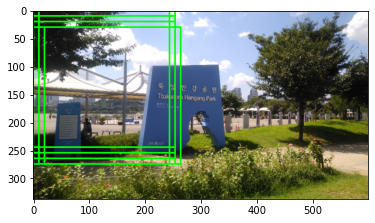

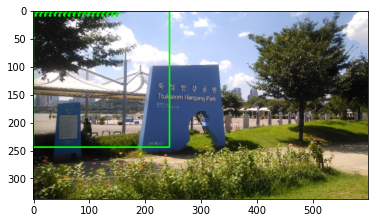

[INFO] showing results for '신세계백화점[본점]'


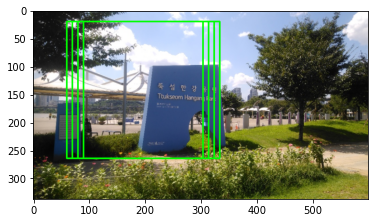

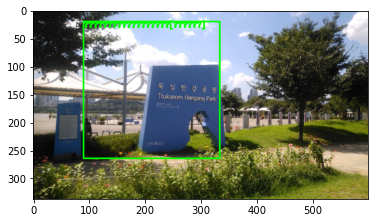

In [45]:
from PIL import ImageFont ,ImageDraw,Image
for label in labels.keys():

    print("[INFO] showing results for '{}'".format(label))
    clone = orig.copy()


    for (box, prob) in labels[label]:
    # 이미지에 경계 상자를 그립니다.
        (startX, startY, endX, endY) = box
        cv2.rectangle(clone, (startX, startY), (endX, endY), (0, 255, 0), 2)



    clone2 = clone[:,:,::-1]
    
    plt.imshow(clone2)
    plt.show()

    clone = orig.copy()

    boxes = np.array([p[0] for p in labels[label]])
    proba = np.array([p[1] for p in labels[label]])
    boxes = non_max_suppression(boxes, proba)
    
    for (startX, startY, endX, endY) in boxes:
        
        cv2.rectangle(clone, (startX, startY), (endX, endY), (0, 255, 0), 2)
        y = startY - 10 if startY - 10 > 10 else startY + 10
        cv2.putText(clone, label,(startX, y),cv2.FONT_HERSHEY_TRIPLEX, 0.45, (0, 255, 0), 2)

    clone2 = clone[:,:,::-1]
    plt.imshow(clone2)
    plt.show()